In [2]:
import polars as pl
import numpy as np
from traffic_data_analysis.utils import load_directional_hourly
import matplotlib.pyplot as plt
from matplotlib import colormaps
from datetime import datetime

In [3]:
df_traffic, df_meta  = load_directional_hourly()
pl.Config.set_tbl_rows(-1)
pl.Config.set_tbl_cols(-1)

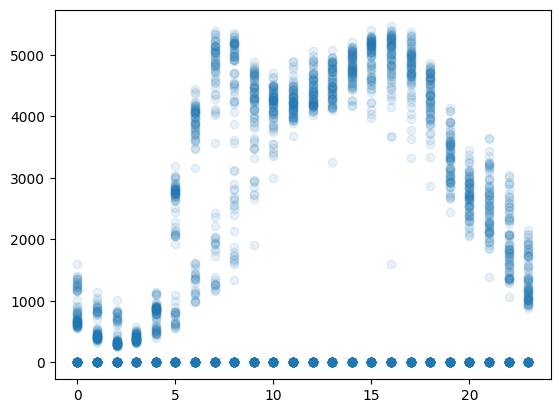

From 2024-10-07 to 2024-12-23 Vista Ridge Tunnel has 1440 hourly entries with 0 and 1872 nonzzero hourly entries


In [4]:
hourly_medians = (
    df_traffic.group_by(["LocationID", "Direction", "Year", "Hour"])
    .agg(pl.col("Volume").median().alias("median"))
)

hours = np.arange(24)

location_id = 26002
hour = 10
thresh = 1

test = df_traffic.filter(
        (pl.col("LocationID") == location_id) &
        (pl.col("Year") == 2024) &
        (pl.col("Volume") < thresh) &
        (pl.col("Hour") > 6) &
        (pl.col("Hour") < 10)
    )

test = test.with_columns([pl.col("DateTime").dt.date().alias("Date")])
unique_days_with_zeros = test["Date"].unique()
start_date = unique_days_with_zeros.min()
end_date = unique_days_with_zeros.max()

sus = df_traffic.filter(
    (pl.col('DateTime').dt.date() >= start_date) & 
    (pl.col('DateTime').dt.date() <= end_date) &
    (pl.col("LocationID") == location_id) &
    (pl.col("Year") == 2024)
)

plt.scatter(sus["Hour"], sus["Volume"], alpha=0.1)
plt.show()

zeros = sus.filter(pl.col('Volume') == 0).height
nonzeros = sus.filter(pl.col('Volume') > 0).height
print(f"From {start_date} to {end_date} Vista Ridge Tunnel has {zeros} hourly entries with 0 and {nonzeros} nonzzero hourly entries") 

In [23]:
def plot_year_scatter(location_id, year):
    fig, axes = plt.subplots(2, 2, figsize=(20, 8))

    sus = df_traffic.filter(
        (pl.col("LocationID") == location_id) &
        (pl.col("Year") == year)
    )
    cmap_name = 'hsv'
    cmap = colormaps[cmap_name]

    for i, (dir_info, group) in enumerate(sus.group_by("Direction")):
        for j, (weekend_info, group) in enumerate((group.group_by("Weekend"))):
            group = group.with_columns([pl.col("DateTime").dt.month().alias("Month")])
            axes[i, j].scatter(group["Hour"], group["Volume"], alpha=0.1, color=cmap((group["Month"]) / 13))
            if weekend_info[0]:
                axes[i, j].set_title(f'{dir_info[0]} Weekend')
            else:
                axes[i, j].set_title(f'{dir_info[0]} Weekday')

    fig.suptitle(f"{location_id}: {year}")
    plt.tight_layout()
    plt.show()

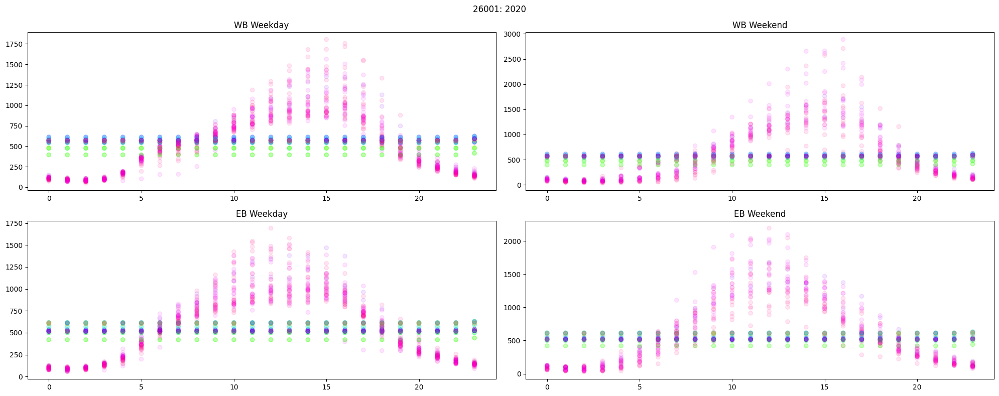

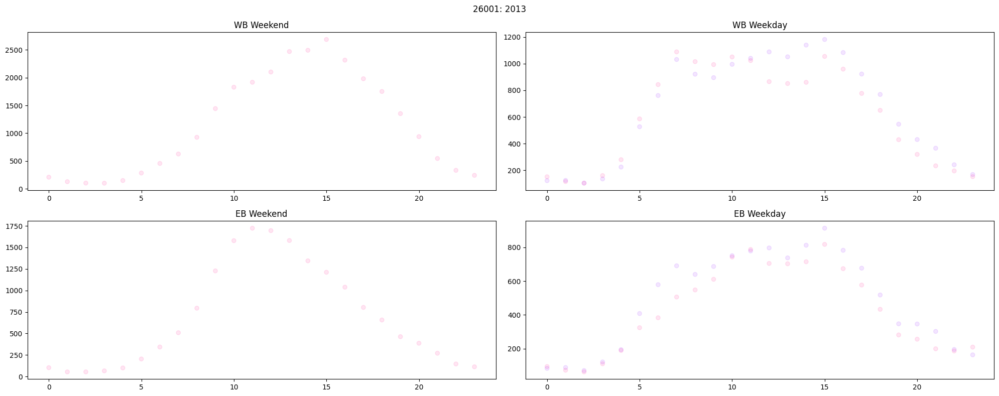

shape: (12, 2)
┌───────┬────────┐
│ Month ┆ median │
│ ---   ┆ ---    │
│ i8    ┆ f64    │
╞═══════╪════════╡
│ 1     ┆ 583.0  │
│ 2     ┆ 593.0  │
│ 3     ┆ 499.5  │
│ 4     ┆ 407.5  │
│ 5     ┆ 487.5  │
│ 6     ┆ 570.0  │
│ 7     ┆ 616.0  │
│ 8     ┆ 612.0  │
│ 9     ┆ 541.5  │
│ 10    ┆ 516.0  │
│ 11    ┆ 102.5  │
│ 12    ┆ 98.5   │
└───────┴────────┘


In [37]:
location_id = 26001
plot_year_scatter(location_id, 2020)
plot_year_scatter(location_id, 2013)

year = 2020
sus = df_traffic.filter(
    (pl.col("LocationID") == location_id) &
    (pl.col("Year") == year) &
    (pl.col("Hour") == 0)
)
            
sus = sus.with_columns([pl.col("DateTime").dt.month().alias("Month")])

month_medians = sus.group_by("Month").agg(pl.col("Volume").median().alias("median")).sort("Month")
print(month_medians)

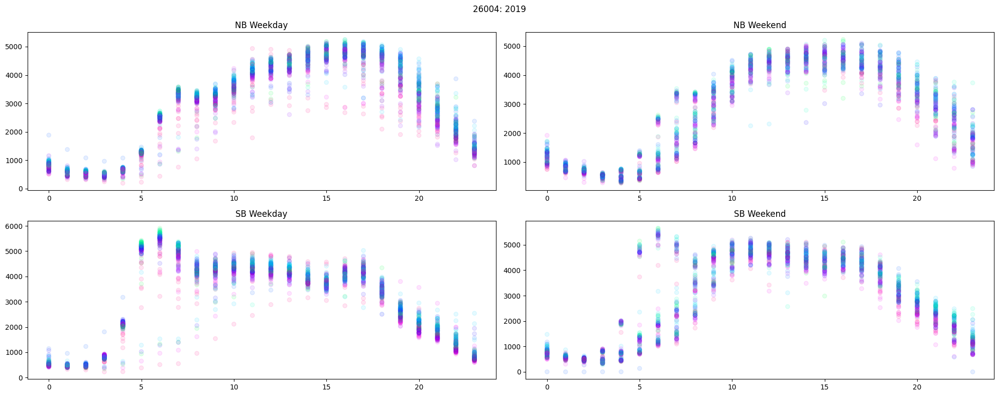

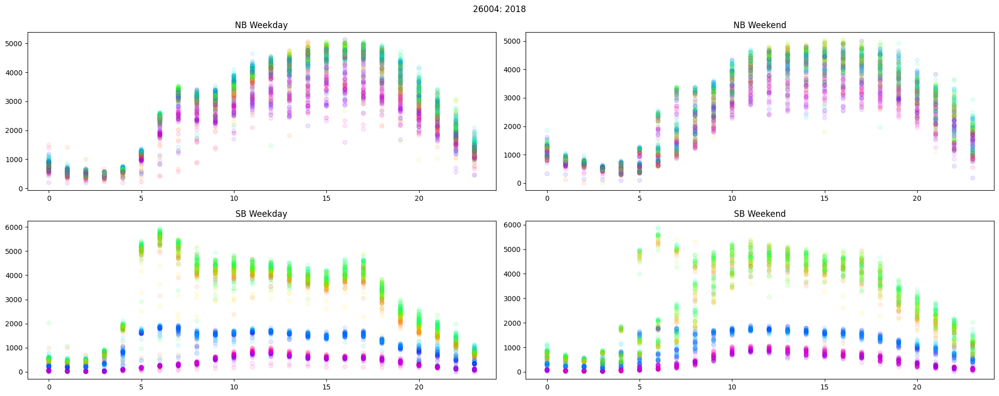

shape: (12, 2)
┌───────┬────────┐
│ Month ┆ median │
│ ---   ┆ ---    │
│ i8    ┆ f64    │
╞═══════╪════════╡
│ 1     ┆ 4013.0 │
│ 2     ┆ 4165.5 │
│ 3     ┆ 4341.0 │
│ 4     ┆ 4349.5 │
│ 5     ┆ 4434.0 │
│ 6     ┆ 4486.0 │
│ 7     ┆ 1618.0 │
│ 8     ┆ 1646.0 │
│ 9     ┆ 1558.5 │
│ 10    ┆ 687.0  │
│ 11    ┆ 715.5  │
│ 12    ┆ 775.0  │
└───────┴────────┘
shape: (8, 2)
┌───────┬────────┐
│ Month ┆ median │
│ ---   ┆ ---    │
│ i8    ┆ f64    │
╞═══════╪════════╡
│ 5     ┆ 4380.0 │
│ 6     ┆ 4524.5 │
│ 7     ┆ 4543.0 │
│ 8     ┆ 4544.0 │
│ 9     ┆ 4393.0 │
│ 10    ┆ 4289.0 │
│ 11    ┆ 4414.5 │
│ 12    ┆ 4383.0 │
└───────┴────────┘


In [34]:
plot_year_scatter(26004, 2019)
plot_year_scatter(26004, 2018)
sus = df_traffic.filter(
    (pl.col("LocationID") == 26004) &
    (pl.col("Year") == 2018) &
    (pl.col("Direction") == "SB") & 
    (pl.col("Hour") == 10)
)
            
sus = sus.with_columns([pl.col("DateTime").dt.month().alias("Month")])
pl.Config.set_tbl_rows(-1)
pl.Config.set_tbl_cols(-1)
month_medians = sus.group_by("Month").agg(pl.col("Volume").median().alias("median")).sort("Month")

print(month_medians)

sus = df_traffic.filter(
    (pl.col("LocationID") == 26004) &
    (pl.col("Year") == 2019) &
    (pl.col("Direction") == "SB") & 
    (pl.col("Hour") == 10)
)
            
sus = sus.with_columns([pl.col("DateTime").dt.month().alias("Month")])
month_medians = sus.group_by("Month").agg(pl.col("Volume").median().alias("median")).sort("Month")

print(month_medians)

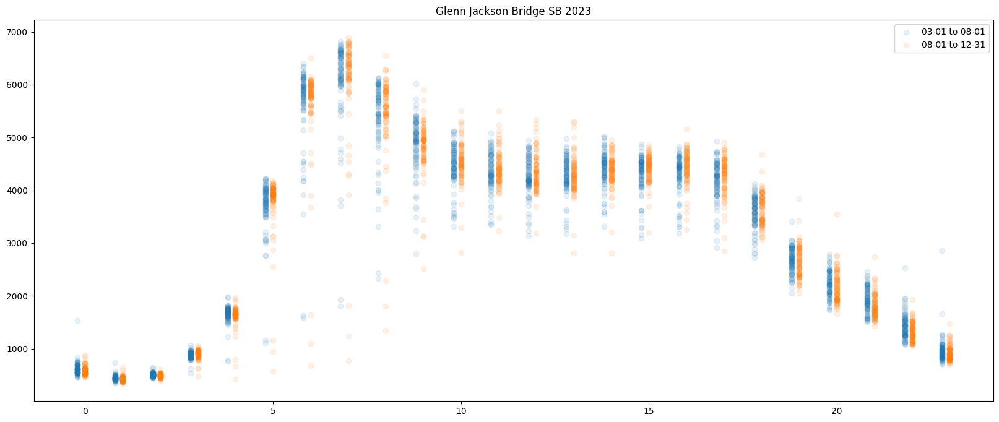

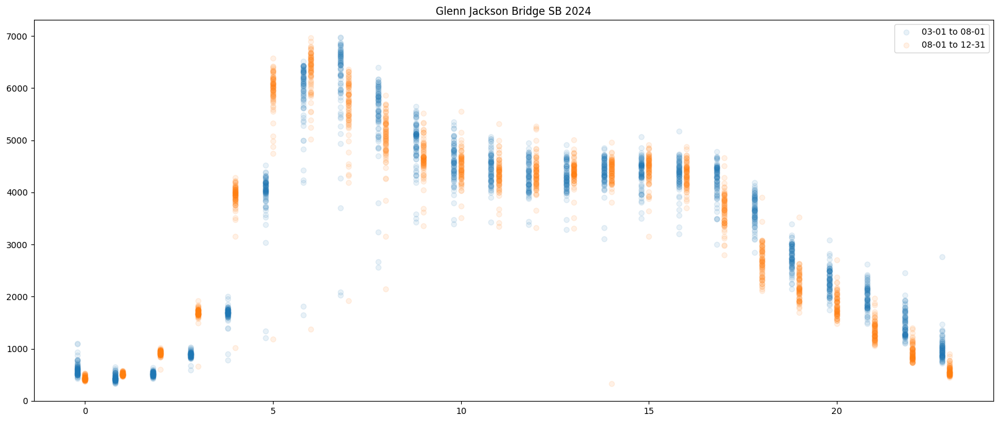

In [22]:
location_id = 26024
direction = 'SB'
date_format = "%Y-%m-%d"
years = [2023, 2024]
for year in years:
    start1= datetime.strptime(f'{year}-08-01', date_format)
    end1=datetime.strptime(f'{year}-12-31', date_format)
    start2=datetime.strptime(f'{year}-03-01', date_format)
    end2=datetime.strptime(f'{year}-08-01', date_format)
    
    summer = df_traffic.filter(
        (pl.col('DateTime').dt.date() > start2) & 
        (pl.col('Direction') == direction) &
        (pl.col('DateTime').dt.date() < end2) &
        (pl.col("LocationID") == location_id) &
        (pl.col("Weekend") == False)
    )
    
    fall = df_traffic.filter(
        (pl.col('DateTime').dt.date() > start1) &
        (pl.col('Direction') == direction) &
        (pl.col('DateTime').dt.date() < end1) &
        (pl.col("LocationID") == location_id) &
        (pl.col("Weekend") == False)
    )
    
    _, ax = plt.subplots(figsize=(20, 8))
    
    ax.scatter(summer["Hour"]-0.2, summer["Volume"], alpha=0.1, color="C0", label=f"{start2.strftime("%m-%d")} to {end2.strftime("%m-%d")}")
    ax.scatter(fall["Hour"], fall["Volume"], alpha=0.1, color="C1", label=f"{start1.strftime("%m-%d")} to {end1.strftime("%m-%d")}")
    plt.title(f"Glenn Jackson Bridge SB {year}")
    plt.legend()
    plt.show()

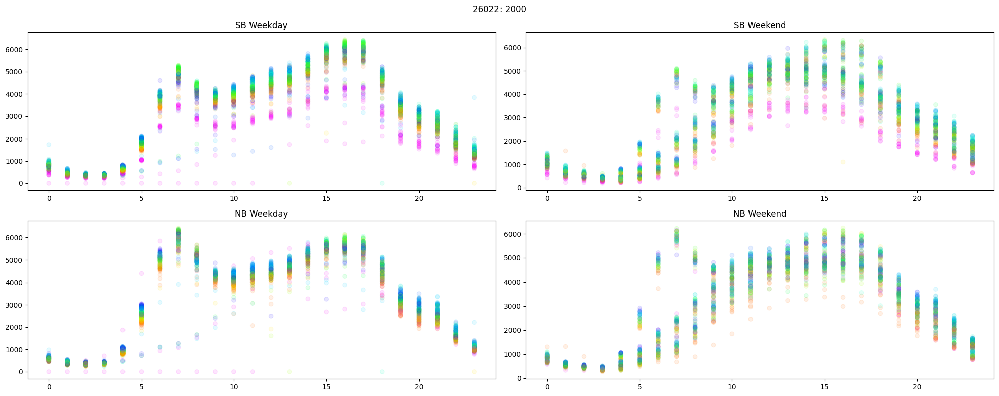

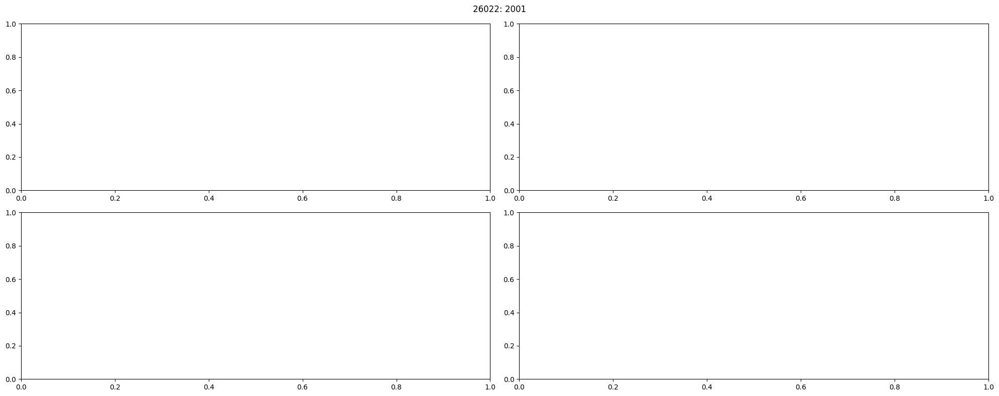

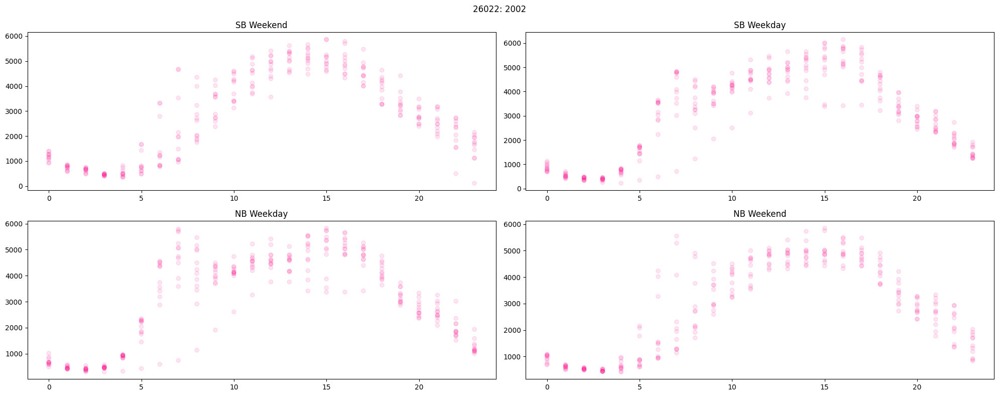

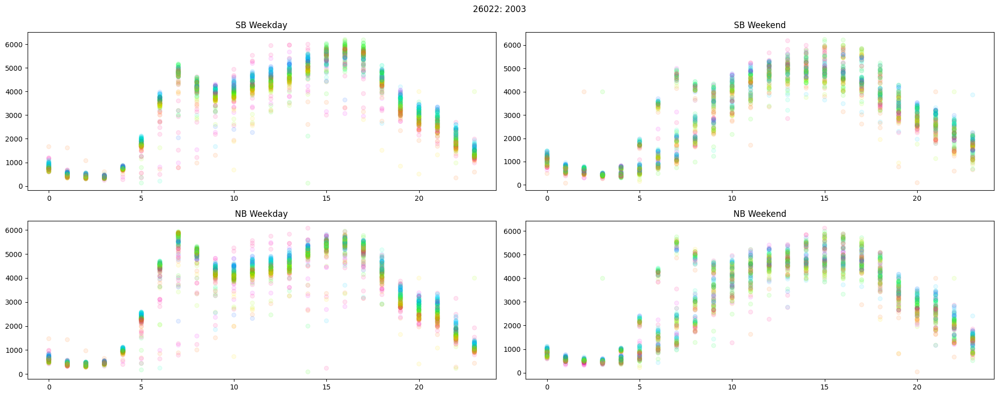

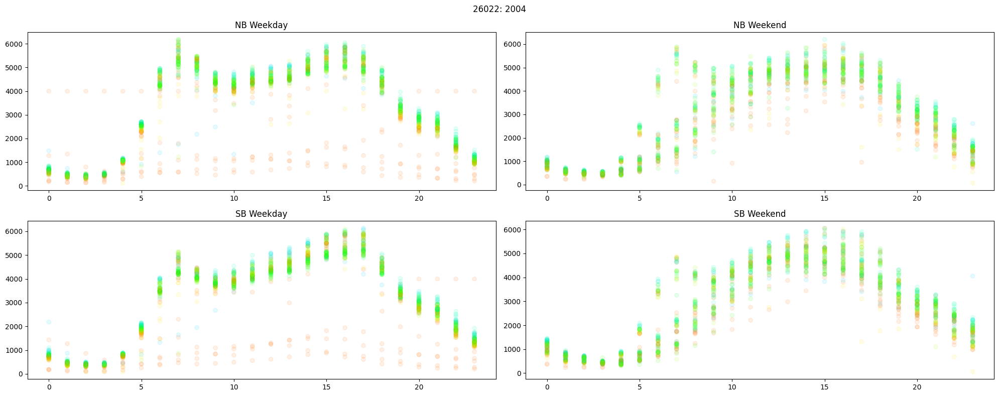

...

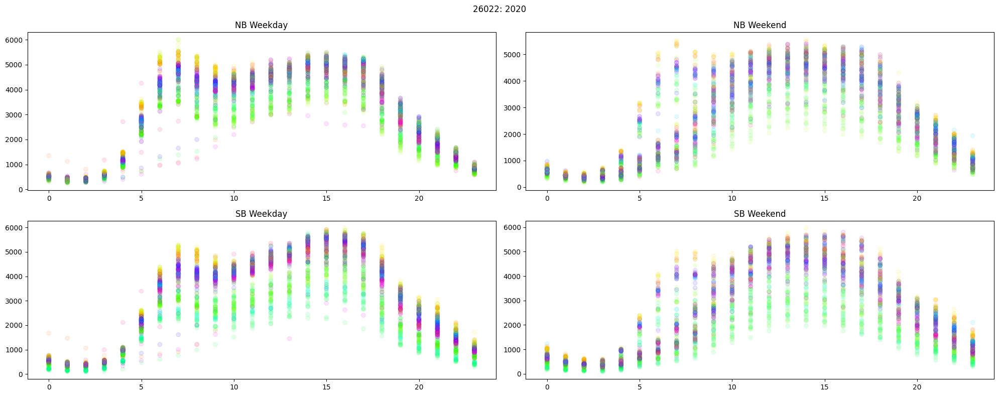

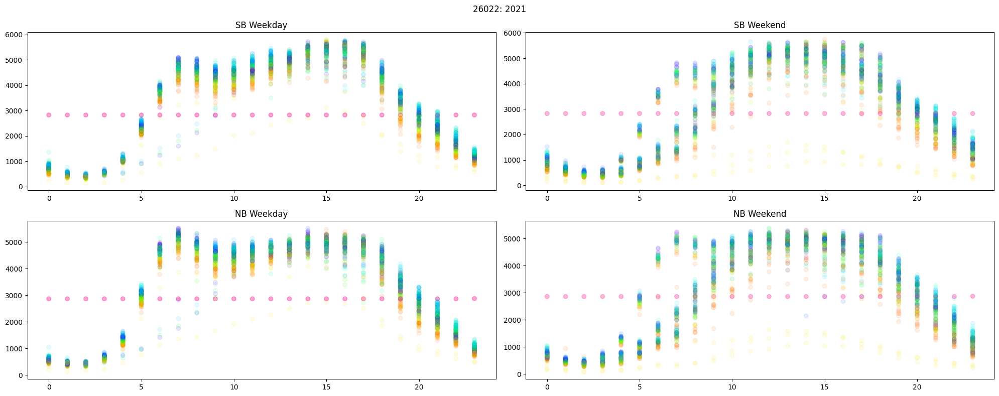

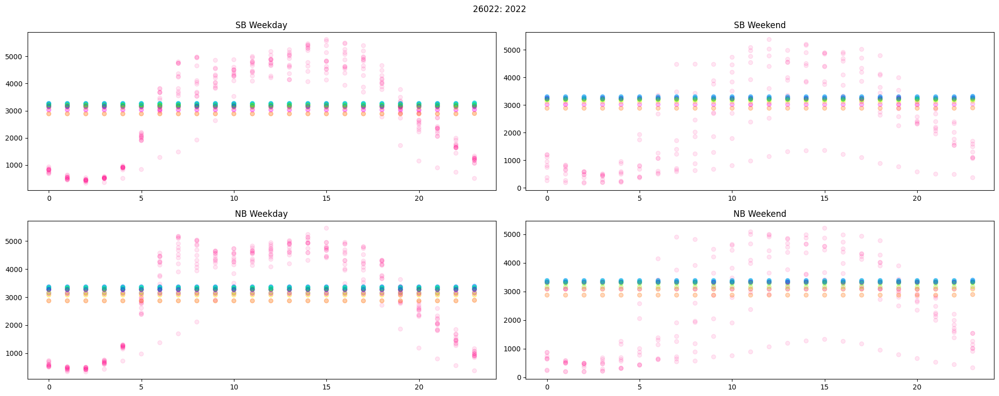

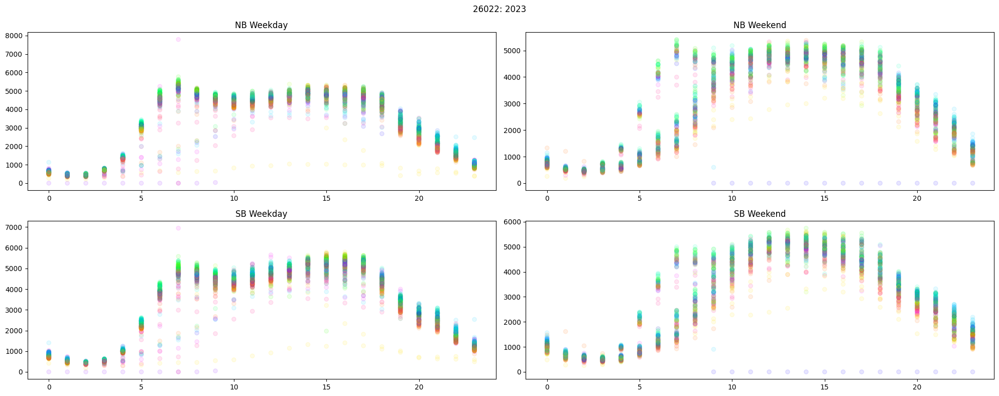

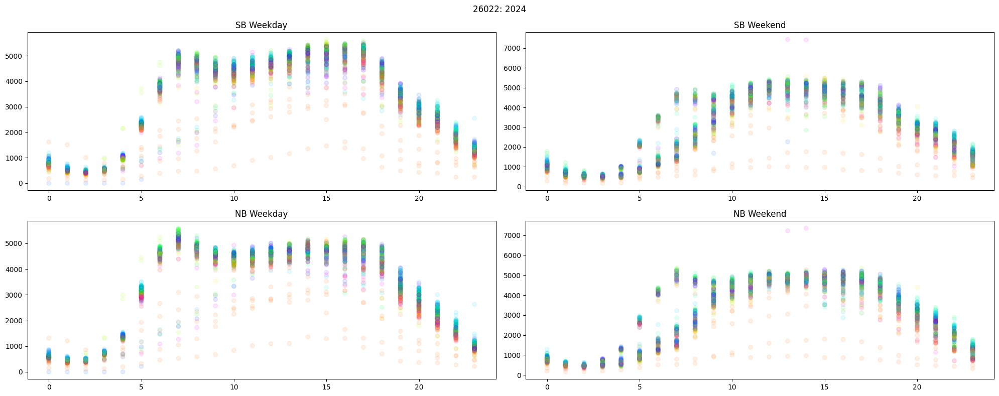

shape: (11, 2)
┌───────┬────────┐
│ Month ┆ median │
│ ---   ┆ ---    │
│ i8    ┆ f64    │
╞═══════╪════════╡
│ 1     ┆ 535.5  │
│ 2     ┆ 520.0  │
│ 3     ┆ 593.0  │
│ 4     ┆ 653.0  │
│ 5     ┆ 735.5  │
│ 6     ┆ 823.5  │
│ 7     ┆ 852.5  │
│ 8     ┆ 804.0  │
│ 9     ┆ 691.0  │
│ 10    ┆ 716.5  │
│ 12    ┆ 2843.5 │
└───────┴────────┘
shape: (12, 2)
┌───────┬────────┐
│ Month ┆ median │
│ ---   ┆ ---    │
│ i8    ┆ f64    │
╞═══════╪════════╡
│ 1     ┆ 2878.5 │
│ 2     ┆ 3097.5 │
│ 3     ┆ 3181.0 │
│ 4     ┆ 3243.5 │
│ 5     ┆ 3272.5 │
│ 6     ┆ 3314.0 │
│ 7     ┆ 3323.0 │
│ 8     ┆ 3336.0 │
│ 9     ┆ 3254.5 │
│ 10    ┆ 3261.0 │
│ 11    ┆ 3058.5 │
│ 12    ┆ 721.5  │
└───────┴────────┘


In [39]:
for year in np.arange(2000, 2025):
    plot_year_scatter(26022, year)

location_id = 26022
year = 2021
sus = df_traffic.filter(
    (pl.col("LocationID") == location_id) &
    (pl.col("Year") == year) &
    (pl.col("Hour") == 0)
)
            
sus = sus.with_columns([pl.col("DateTime").dt.month().alias("Month")])

month_medians = sus.group_by("Month").agg(pl.col("Volume").median().alias("median")).sort("Month")
print(month_medians)
year = 2022
sus = df_traffic.filter(
    (pl.col("LocationID") == location_id) &
    (pl.col("Year") == year) &
    (pl.col("Hour") == 0)
)
            
sus = sus.with_columns([pl.col("DateTime").dt.month().alias("Month")])

month_medians = sus.group_by("Month").agg(pl.col("Volume").median().alias("median")).sort("Month")
print(month_medians)

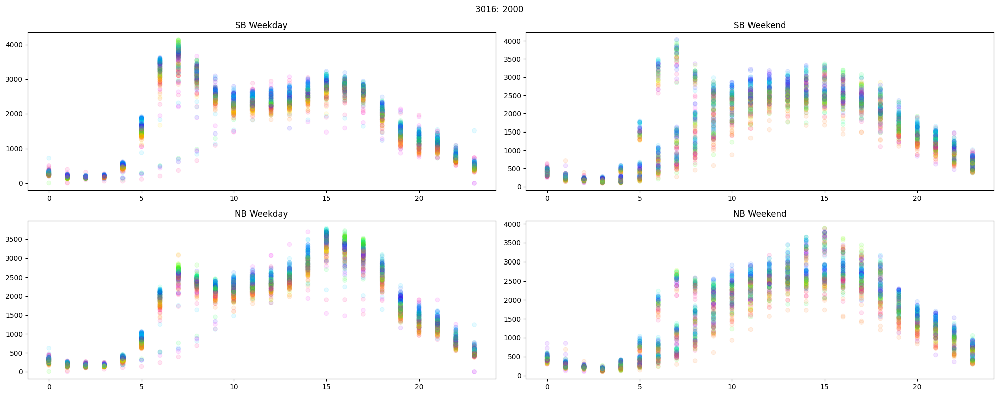

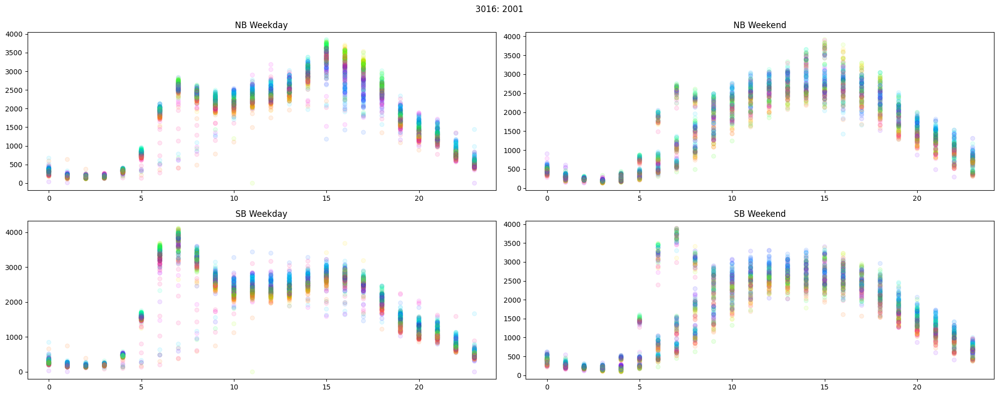

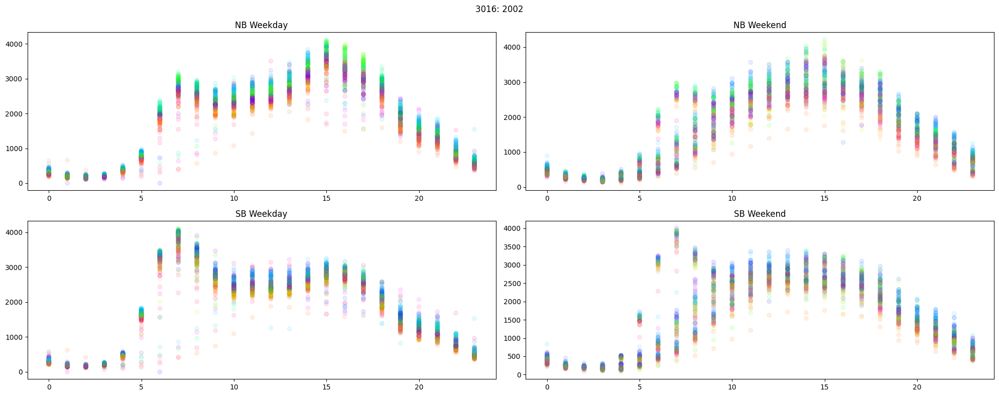

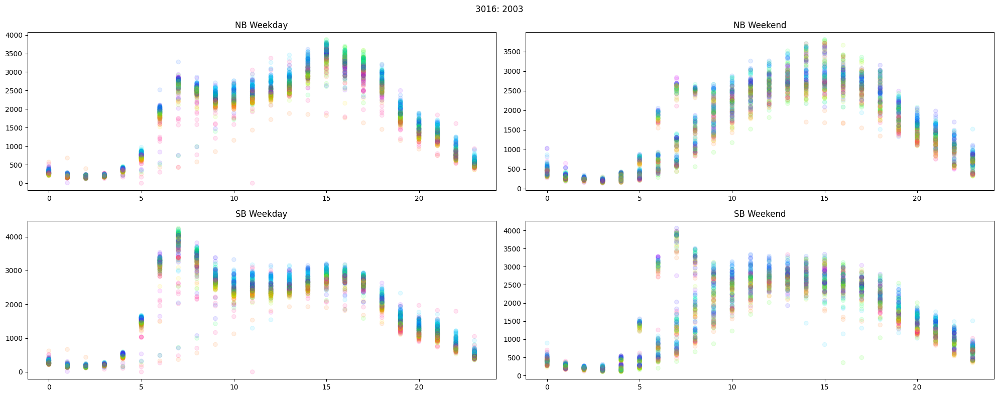

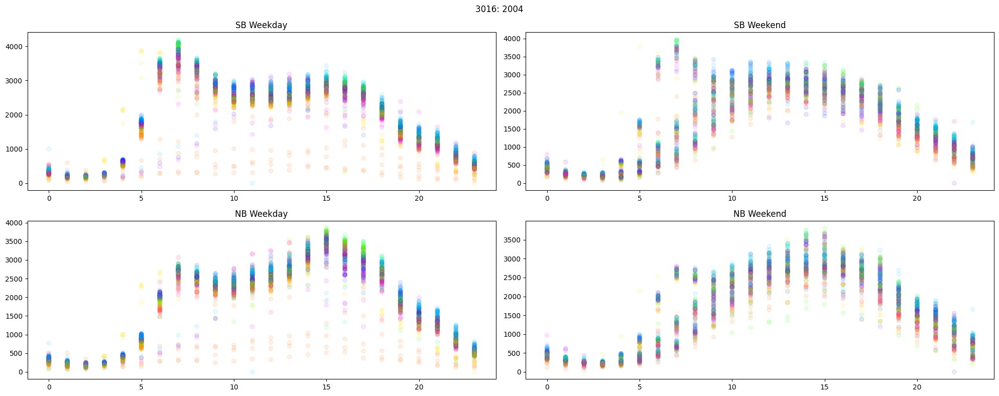

...

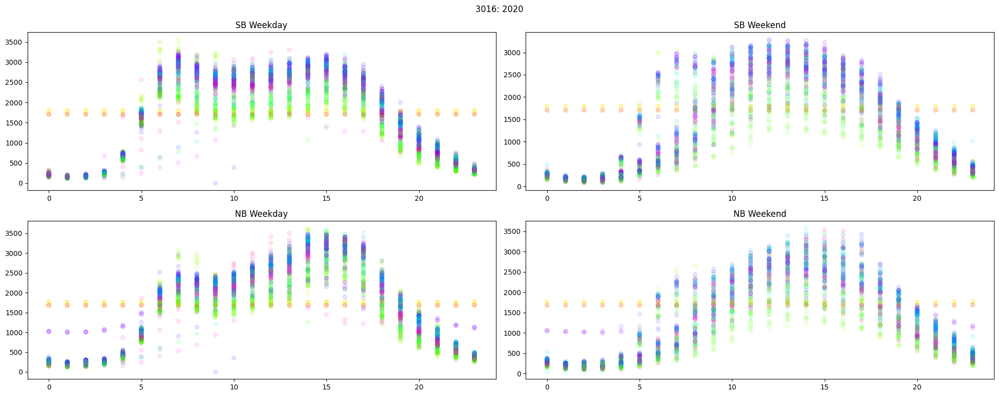

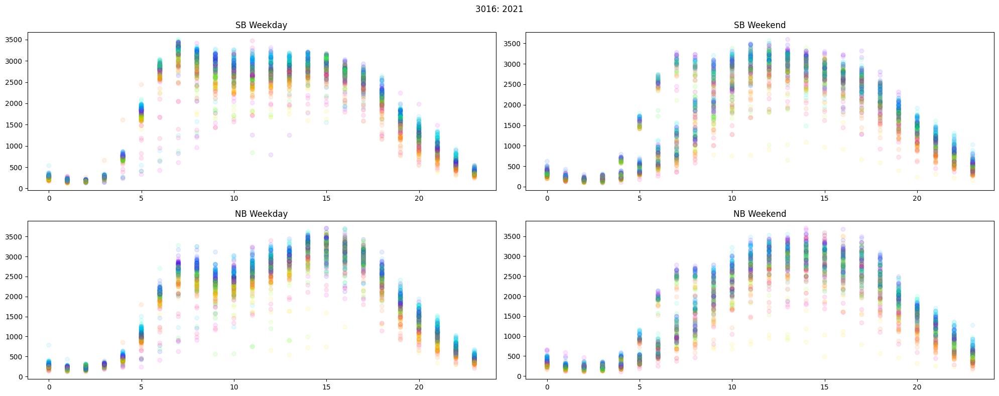

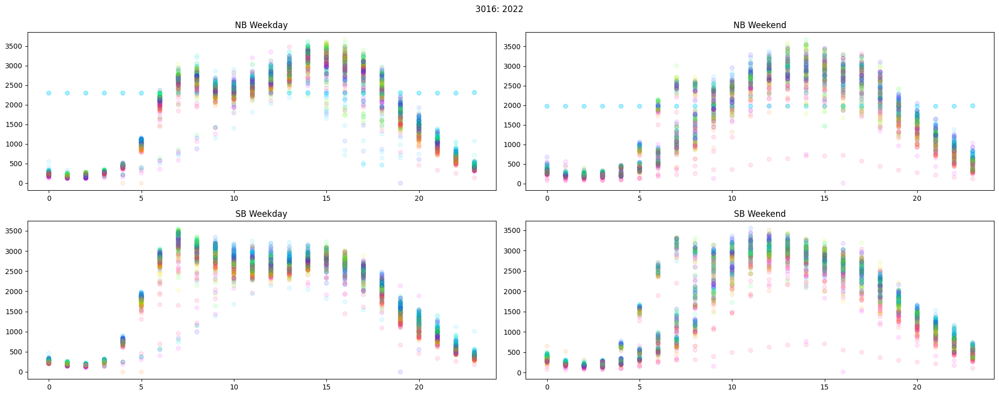

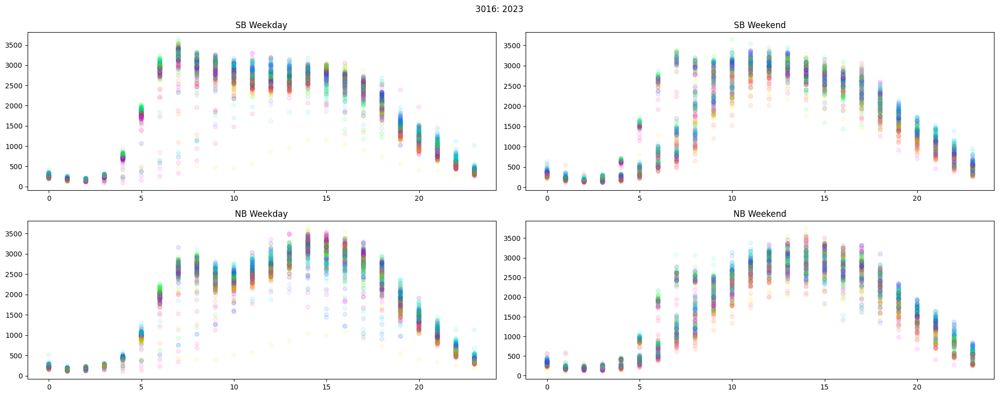

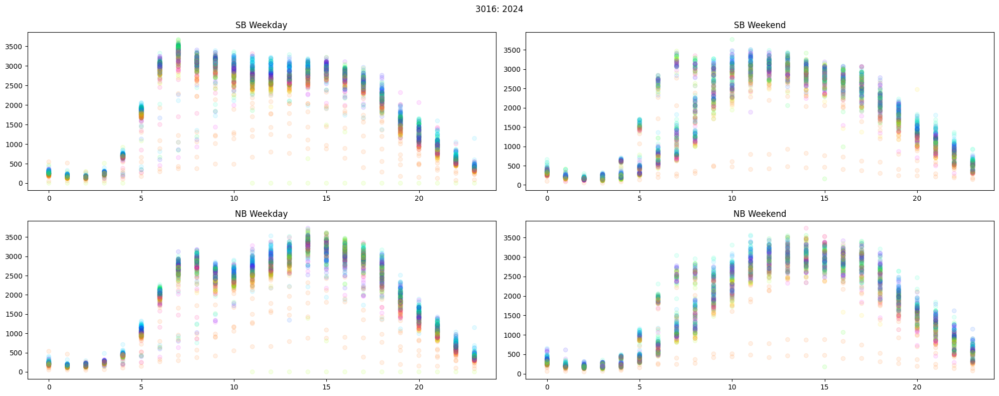

shape: (12, 2)
┌───────┬──────┐
│ Month ┆ max  │
│ ---   ┆ ---  │
│ i8    ┆ i64  │
╞═══════╪══════╡
│ 1     ┆ 1706 │
│ 2     ┆ 1797 │
│ 3     ┆ 363  │
│ 4     ┆ 261  │
│ 5     ┆ 325  │
│ 6     ┆ 330  │
│ 7     ┆ 532  │
│ 8     ┆ 383  │
│ 9     ┆ 375  │
│ 10    ┆ 1075 │
│ 11    ┆ 394  │
│ 12    ┆ 321  │
└───────┴──────┘
shape: (12, 2)
┌───────┬──────┐
│ Month ┆ max  │
│ ---   ┆ ---  │
│ i8    ┆ i64  │
╞═══════╪══════╡
│ 1     ┆ 652  │
│ 2     ┆ 370  │
│ 3     ┆ 397  │
│ 4     ┆ 425  │
│ 5     ┆ 492  │
│ 6     ┆ 505  │
│ 7     ┆ 2298 │
│ 8     ┆ 472  │
│ 9     ┆ 677  │
│ 10    ┆ 508  │
│ 11    ┆ 528  │
│ 12    ┆ 461  │
└───────┴──────┘


In [41]:
for year in np.arange(2000, 2025):
    plot_year_scatter(3016, year)

location_id = 3016
year = 2020
sus = df_traffic.filter(
    (pl.col("LocationID") == location_id) &
    (pl.col("Year") == year) &
    (pl.col("Hour") == 0)
)
            
sus = sus.with_columns([pl.col("DateTime").dt.month().alias("Month")])

month_medians = sus.group_by("Month").agg(pl.col("Volume").max().alias("max")).sort("Month")
print(month_medians)
year = 2022
sus = df_traffic.filter(
    (pl.col("LocationID") == location_id) &
    (pl.col("Year") == year) &
    (pl.col("Hour") == 0)
)
            
sus = sus.with_columns([pl.col("DateTime").dt.month().alias("Month")])

month_medians = sus.group_by("Month").agg(pl.col("Volume").max().alias("max")).sort("Month")
print(month_medians)

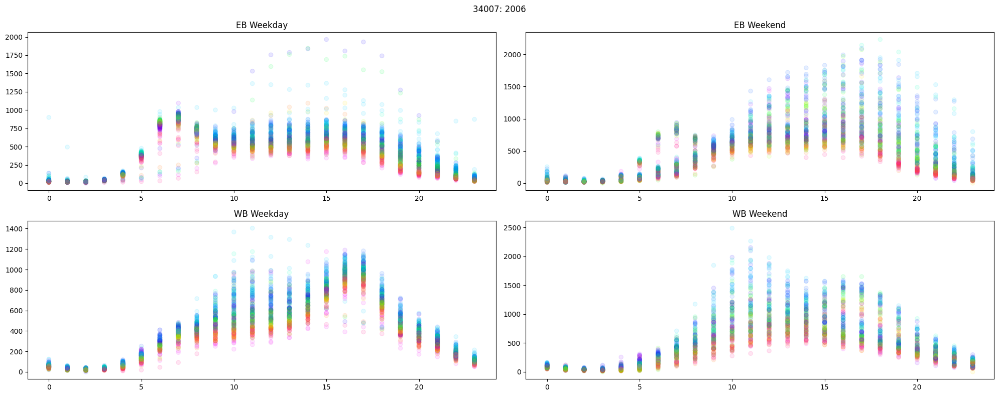

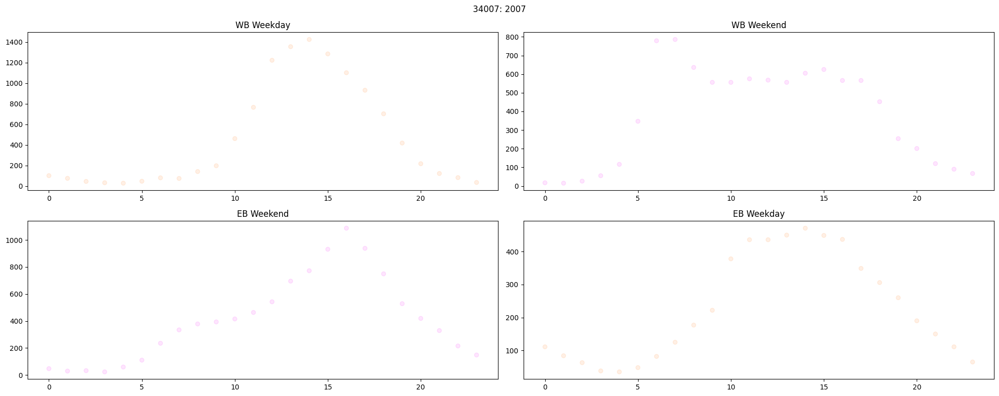

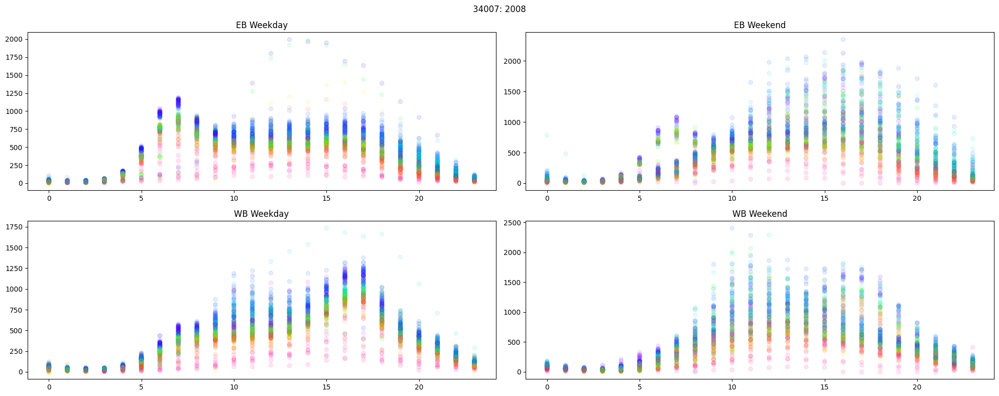

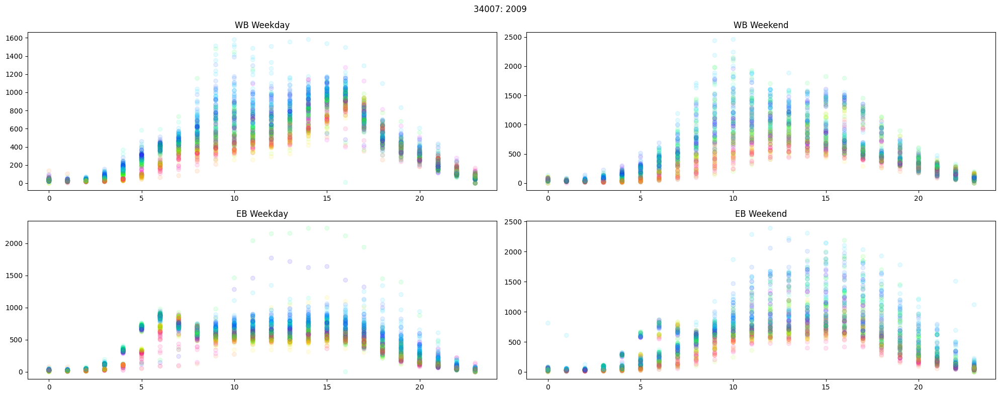

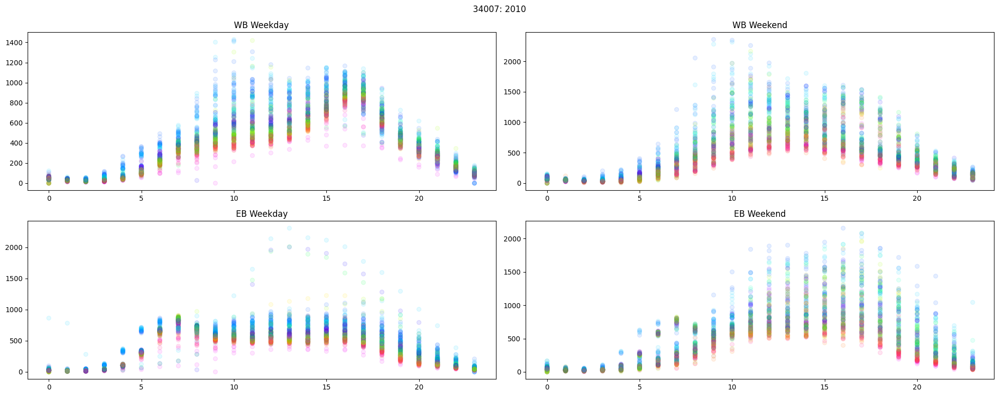

...

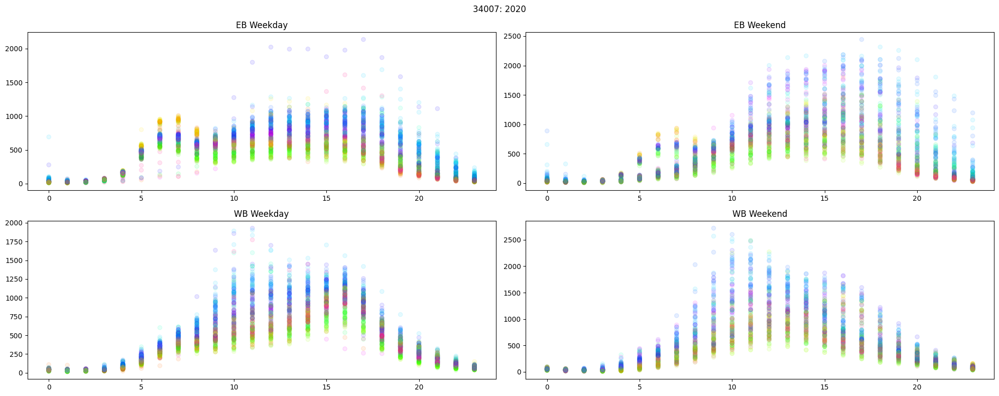

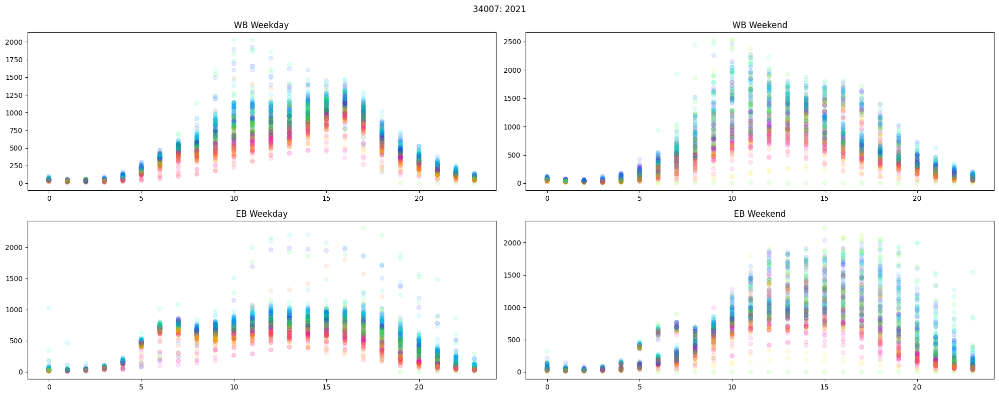

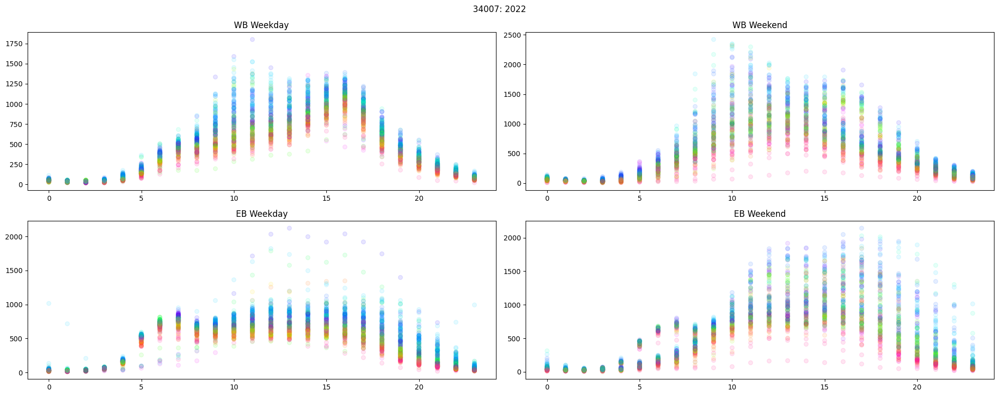

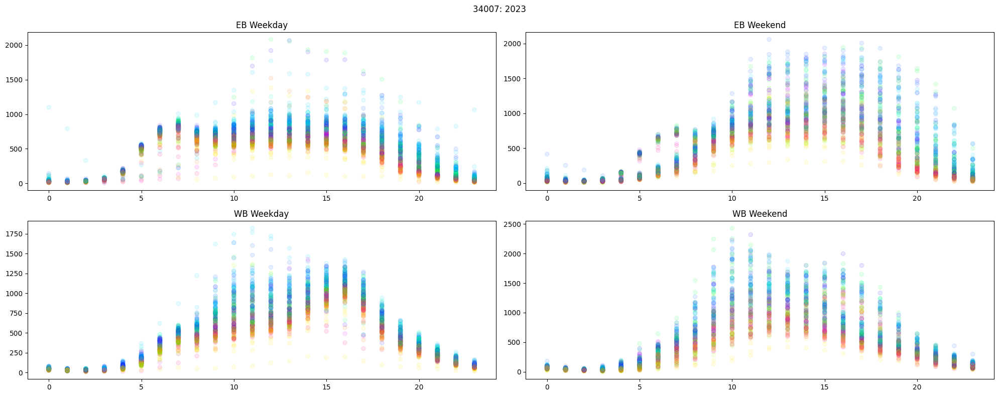

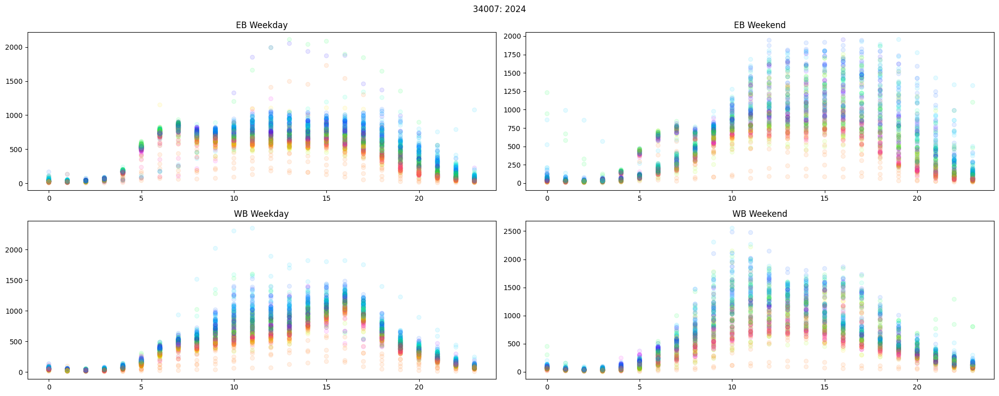

In [29]:
for year in np.arange(2006, 2025):
    plot_year_scatter(34007, year)